## Notebook to visualize Dec. 1th 2015 with RA autoencoder
model experiment number: 64541244

In [2]:
%reload_ext autoreload
%autoreload 2
import os
import gc
import re
import sys
import glob
import numpy as np
import scipy as sc
import pandas as pd
import tensorflow as tf
import matplotlib
import matplotlib.pyplot as plt
from pyhdf.SD import SD, SDC 
from scipy.stats import mode
from tensorflow.python.keras.models import Model
from tensorflow.data.experimental import parallel_interleave
 
from matplotlib.colors import LinearSegmentedColormap
from matplotlib import patches as mpl_patches
from sklearn.cluster import AgglomerativeClustering as HAC
from sklearn.manifold import TSNE

# for centroid
from scipy.cluster.hierarchy import centroid, fcluster
from scipy.spatial.distance import pdist
from sklearn.metrics.pairwise import euclidean_distances

In [3]:
from scipy.cluster.hierarchy import dendrogram
# https://scikit-learn.org/stable/auto_examples/cluster/plot_agglomerative_dendrogram.html
from sklearn.neighbors import NearestCentroid
# https://stackoverflow.com/questions/56456572/how-to-get-agglomerative-clustering-centroid-in-python-scikit-learn
from matplotlib.backends.backend_pdf import PdfPages
libdir = '/home/tkurihana/scratch-midway2/clouds/src_analysis/lib_hdfs'
sys.path.insert(1,os.path.join(sys.path[0],libdir))
from alignment_lib import  decode_cloud_flag, const_clouds_array
from analysis_lib import _get_colors, _gen_patches
from lib_modis02 import proc_sds

In [53]:
from PIL import Image, ImageEnhance

In [4]:
def load_latest_model(model_dir, mtype):
    #TODO add restart model dir and restart argument?
    latest = 0, None
    # get trained wegiht 
    for m in os.listdir(model_dir):
        if ".h5" in m and mtype in m:
            epoch = int(m.split("-")[1].replace(".h5", ""))
            latest = max(latest, (epoch, m))

    epoch, model_file = latest

    if not os.listdir(model_dir):
        raise NameError("no directory. check model path again")

    print(" Load {} at {} epoch".format(mtype, epoch))
    model_def = model_dir+'/'+mtype+'.json'
    model_weight = model_dir+'/'+mtype+'-'+str(epoch)+'.h5'
    with open(model_def, "r") as f:
        model = tf.keras.models.model_from_json(f.read())
    model.load_weights(model_weight)
    return model

In [5]:
def data_extractor_fn(filelist,prefetch=1,height=None, width=None, read_threads=1, distribute=(1, 0), shape_size=2):
    def parser(ser):
        """
        Decode & Pass datast in tf.record
        *Cuation*
        floating point: tfrecord data ==> tf.float64
        """

        features = {
            "shape": tf.FixedLenFeature([shape_size], tf.int64),
            "patch": tf.FixedLenFeature([], tf.string),
            "filename": tf.FixedLenFeature([], tf.string),
            "coordinate": tf.FixedLenFeature([2], tf.int64),
        }        
        decoded = tf.parse_single_example(ser, features)
        patch = tf.reshape(
            tf.decode_raw(decoded["patch"], tf.float64), decoded["shape"]
        )
        patch = tf.image.resize(tf.expand_dims(patch, axis=0), (height, width))
        coord = decoded['coordinate']
        return patch, coord
    
    dataset = (
        tf.data.Dataset.list_files(filelist, shuffle=True)
            .shard(*distribute)
            .apply(
            parallel_interleave(
                lambda f: tf.data.TFRecordDataset(f).map(parser),
                cycle_length=read_threads,
                sloppy=True,
            )
        )
    )
    iterator = dataset.make_one_shot_iterator()

    next_element = iterator.get_next()
    patch_list = []
    coord_list = []
    with tf.Session() as sess:
        try:
            while True:
                patch, coord = sess.run(next_element)
                patch_list.append(patch)
                coord_list.append(coord)
        except tf.errors.OutOfRangeError:
            print("OutOfRage --> finish process")
            pass
    return patch_list, coord_list

### Load RGB band (band 1, 4,3)
True color image defined by `https://neo.sci.gsfc.nasa.gov/view.php?datasetId=MYD_143D_RR`

In [34]:
def zscore(data):
    return (data - np.nanmin(data)) / (np.nanmax(data) - np.nanmin(data))

In [35]:
#Access visual data
hdf_datadir = '/home/tkurihana/clouds/analysis_mod021KM/data/MOD02'
for idx, ich in enumerate([1,2,1]): # 1, 4 3,
    if idx == 0:
        vis_file = os.path.join(hdf_datadir,
        f"MOD021KM.A2015335.mosaic.061.2019272193957.psmcgscs_000501379937.EV_250_Aggr1km_RefSB_{ich}.hdf")
        vhdf = SD(vis_file, SDC.READ)
        vhdf_sds = vhdf.select("EV_250_Aggr1km_RefSB")
    else:
        vis_file = os.path.join(hdf_datadir,
        f"MOD021KM.A2015335.mosaic.061.2019271223018.psmcgscs_000501379735.EV_500_Aggr1km_RefSB_{ich}.hdf")
        print(vis_file)
        vhdf = SD(vis_file, SDC.READ)
        vhdf_sds = vhdf.select("EV_500_Aggr1km_RefSB")
    if idx == 0:
        vhdf_array, vis_band = proc_sds(vhdf_sds)
        vhdf_array = np.expand_dims(vhdf_array, axis=-1)
        # standarized to 0-1
        vhdf_array = zscore(vhdf_array)
        print(vhdf_array.shape)
    else:
        tmp_array, _ = proc_sds(vhdf_sds)
        tmp_array    = np.expand_dims(tmp_array, axis=-1)
        tmp_array = zscore(tmp_array)
        print(vhdf_array.shape)
        vhdf_array = np.concatenate([vhdf_array, tmp_array], axis=-1)
vhdf_array.shape

Process bands 1
(3562, 3540, 1)
/home/tkurihana/clouds/analysis_mod021KM/data/MOD02/MOD021KM.A2015335.mosaic.061.2019271223018.psmcgscs_000501379735.EV_500_Aggr1km_RefSB_2.hdf
Process bands 4
(3562, 3540, 1)
/home/tkurihana/clouds/analysis_mod021KM/data/MOD02/MOD021KM.A2015335.mosaic.061.2019271223018.psmcgscs_000501379735.EV_500_Aggr1km_RefSB_1.hdf
Process bands 3
(3562, 3540, 2)


(3562, 3540, 3)

In [36]:
np.nanmax(vhdf_array),np.nanmin(vhdf_array)

(1.0, 0.0)

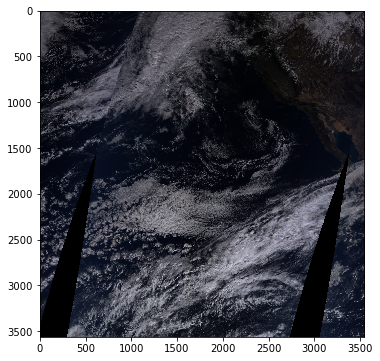

In [38]:
plt.figure(figsize=(8,6))
plt.imshow(vhdf_array)
plt.show()

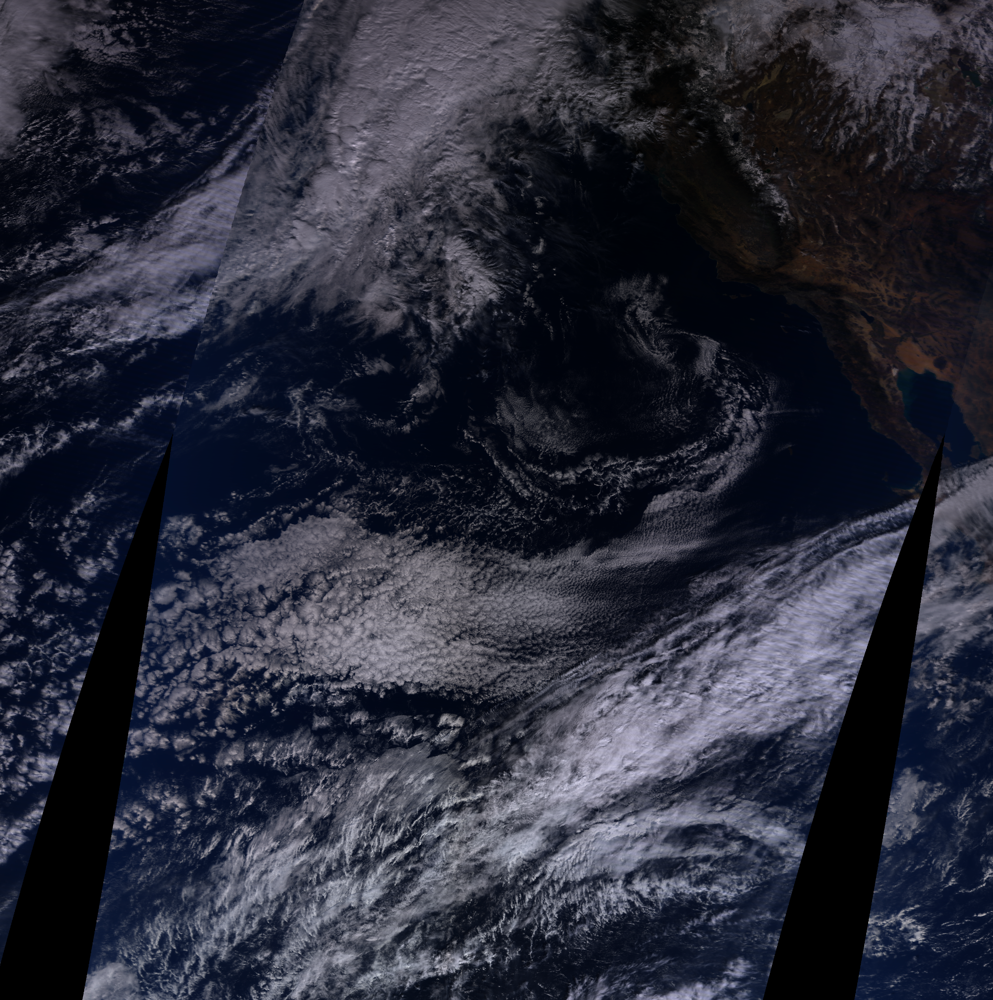

In [54]:
im = Image.fromarray(np.uint8(vhdf_array*255)).convert('RGB')
con5 = ImageEnhance.Color(im)
con5_image = con5.enhance(1.5)
con5_image

### Load dataset

In [6]:
tf_datadir = "/project2/foster/clouds/data/clouds_laads_multiprocessed_20151201"

In [7]:
patches_list = []
h=w=128
shape_size=3
patches_list, coord_list = data_extractor_fn(os.path.join(tf_datadir, '*tfrecord'), height=h, width=w,shape_size=shape_size)
print("NORMAL END")

Instructions for updating:
Use `tf.data.Dataset.interleave(map_func, cycle_length, block_length, num_parallel_calls=tf.data.experimental.AUTOTUNE)` instead. If sloppy execution is desired, use `tf.data.Options.experimental_determinstic`.
Instructions for updating:
Use `for ... in dataset:` to iterate over a dataset. If using `tf.estimator`, return the `Dataset` object directly from your input function. As a last resort, you can use `tf.compat.v1.data.make_one_shot_iterator(dataset)`.
OutOfRage --> finish process
NORMAL END


In [8]:
patches = np.concatenate(patches_list, axis=0)
patches.shape

(491, 128, 128, 6)

In [39]:
gc.collect()

18017

---------------------
### Clustering 

In [40]:
def compute_hac3(encoder, decoder=None, clf=None,patches=None,layer_name="leaky_re_lu_23"):
    # RI model
    #encs = encoder.predict(patches)
    pred = encoder.predict(patches)
    gc.collect()

    # get another layers from Decoder
    #model = decoder
    #rep  = Model(inputs=model.input, outputs=model.get_layer(layer_name).output)
    #pred = rep.predict(encs)

    n,h,w,c = pred.shape
    clustering = clf.fit(pred.reshape(n, h*w*c))
    clabels = clustering.labels_
    return clabels, clustering, pred

##### Load model and set classifier

In [41]:
model_datadir = '/home/tkurihana/rotate_invariant/stepbystep/transform/output_model'

In [42]:
expname = '64541244'

In [43]:
model_dir = os.path.join(model_datadir,str(expname) )
encoder = load_latest_model(model_dir, mtype='encoder')
decoder = load_latest_model(model_dir, mtype='decoder')

 Load encoder at 49 epoch
Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor
Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor
Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor
 Load decoder at 49 epoch
Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor


##### Set up ncluster for HAC

In [44]:
nclusters = 12

In [45]:
clf_dict = {
    'HAC': HAC(n_clusters=nclusters,memory=None,compute_full_tree=True,
               compute_distances=True) ,
}
# define a model selected from metrics
clf = clf_dict['HAC']

In [46]:
clabels, clustering, pred = compute_hac3(encoder,decoder,clf,patches,
                                         layer_name=None)

----------------------
#### Visualize on map

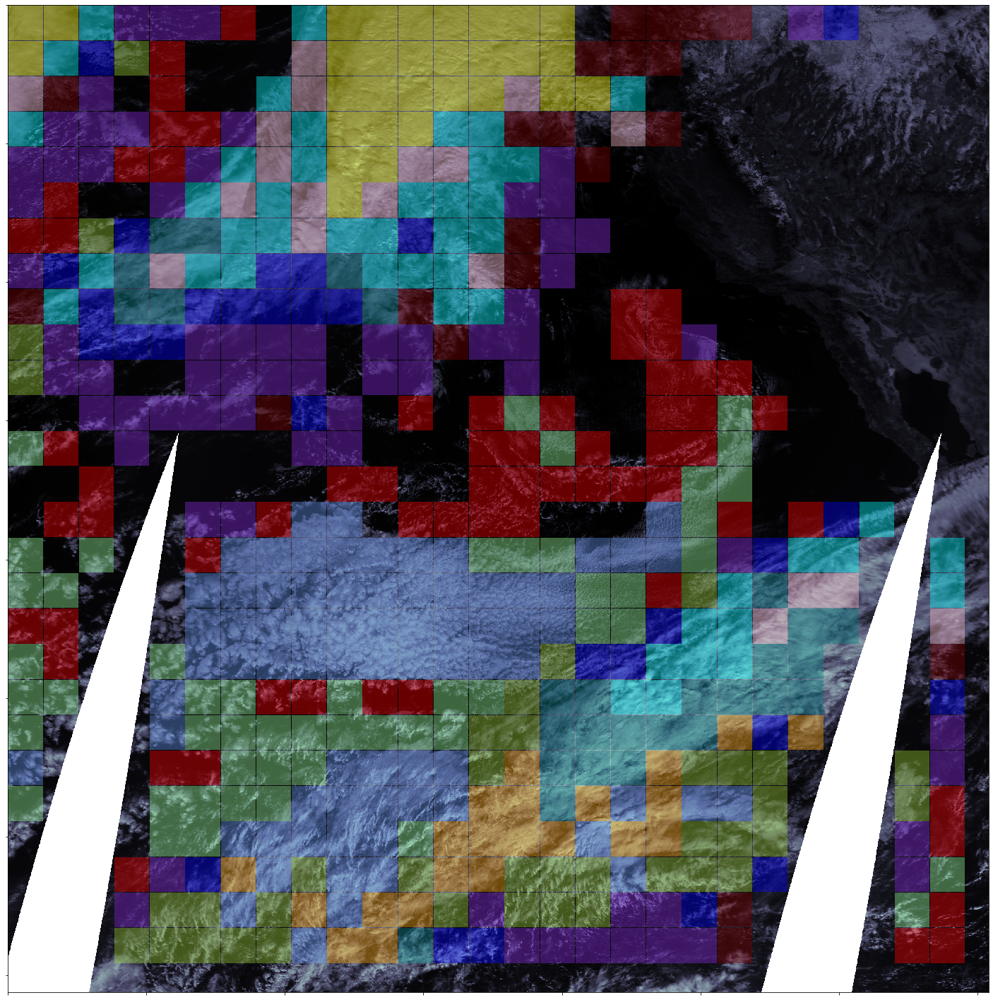

In [57]:
#Plot location of cluster patches on top of visual band image
fig = plt.figure(figsize=(20,20))

line_width = 1
SHAPE = 1,1 #128,128
_SHAPE = 128,128
colors = ['blueviolet','cornflowerblue','blue','teal',
         'aqua','palegreen', 'yellowgreen', 'pink',
         'yellow','orange','red','maroon', 'Grey']

ax = plt.subplot(1,1,1)
plt.imshow(vhdf_array[:,:,0], cmap='bone')
#plt.imshow(con5_image)
for idx, (coord,icluster) in enumerate(zip(coord_list, clabels)):  
    i,j = coord
    ax.add_patch(mpl_patches.Rectangle(
        (j * SHAPE[0] + line_width , i * SHAPE[1] + line_width ),
        width=_SHAPE[0] - line_width * 2,
        height=_SHAPE[1] - line_width * 2,
        linewidth=0,
        edgecolor=colors[icluster],
        facecolor='none',
        alpha=0.25
    ))
    #======================================
    ax.add_patch(mpl_patches.Rectangle(
        (j * SHAPE[0] + line_width , i * SHAPE[1] + line_width ),
        width=_SHAPE[0] - line_width * 2,
        height=_SHAPE[1] - line_width * 2,
        linewidth=0,
        edgecolor=colors[icluster],
        facecolor=colors[icluster],
        alpha=0.4  #0.57
    ))
                    
fig.tight_layout()
ax.set_yticklabels([])
ax.set_xticklabels([])
plt.show()
#plt.savefig("Visual_clusters_
plt.close()